In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn import metrics
from sklearn.model_selection import cross_val_score, StratifiedKFold
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import RandomForestClassifier

iris = pd.read_csv('../final_csv/reduced_iris.csv')
raisin = pd.read_csv('../final_csv/reduced_raisin.csv')

In [2]:
num_columns = iris.shape[1]
print("Number of columns:", num_columns)
iris = iris[['SepalLengthCm', 'SepalWidthCm', 'PetalLengthCm', 'PetalWidthCm', 'Species']]
raisin = raisin[['majoraxislength', 'perimeter', 'convexarea', 'area', 'class']]
iris['Species'] = iris['Species'].map({'Iris-setosa': 0, 'Iris-versicolor': 1, 'Iris-virginica': 2})

iris_columns = iris.columns
raisin_columns = raisin.columns

accuracy_overall_knn = []
accuracy_overall_mlp = []
data = iris.copy()

Number of columns: 5


In [3]:
def calculate_stats_knn(data):
    temp = data.copy()
    X = temp.drop('Species', axis=1)
    Y = temp['Species'].astype('int')

    n_splits = 10
    skf = StratifiedKFold(n_splits, shuffle=True, random_state=10)
    average_accuracy=0

    for fold, (train_index, test_index) in enumerate(skf.split(X, Y)):
        X_train = X.take(train_index)
        y_train = Y.take(train_index)
        X_test = X.take(test_index)
        y_test = Y.take(test_index)

        knn_classifier = KNeighborsClassifier()
        knn_classifier.fit(X_train, y_train)

        y_pred = knn_classifier.predict(X_test)

        accuracy = round(metrics.accuracy_score(y_test, y_pred), 2)
        #print("Accuracy:", accuracy)
        average_accuracy = average_accuracy + accuracy
        cross_val_scores = cross_val_score(knn_classifier, X, Y, cv=4)
        cross_val_scores = [round(score, 2) for score in cross_val_scores]

        #print("Cross-Validation Scores:", cross_val_scores)

    average_accuracy = average_accuracy/n_splits

    return average_accuracy

In [4]:
def calculate_stats_mlp(data):
    temp = data.copy()
    X = temp.drop('Species', axis=1)
    Y = temp['Species'].astype('int')

    n_splits = 10
    skf = StratifiedKFold(n_splits, shuffle=True, random_state=10)
    average_accuracy = 0

    for fold, (train_index, test_index) in enumerate(skf.split(X, Y)):
        X_train = X.take(train_index)
        y_train = Y.take(train_index)
        X_test = X.take(test_index)
        y_test = Y.take(test_index)

        rf_classifier = RandomForestClassifier()
        rf_classifier.fit(X_train, y_train)

        y_pred = rf_classifier.predict(X_test)

        accuracy = round(metrics.accuracy_score(y_test, y_pred), 2)
        average_accuracy = average_accuracy + accuracy
        cross_val_scores = cross_val_score(rf_classifier, X, Y, cv=4)
        cross_val_scores = [round(score, 2) for score in cross_val_scores]

    average_accuracy = average_accuracy / n_splits

    return average_accuracy

In [5]:
def calculate_distance(source, target, data_actual):
    distance_from_source = source - data_actual
    distance_to_target = target - data_actual
    total_distance = target - source 
    if distance_from_source == 0:
        return -1
    elif distance_to_target == 0:
        return 1
    else:
        return (data_actual - source) / total_distance

In [6]:
def is_average_greater_than_half(distance_array):
    average = np.mean(distance_array)
    if average >= 0.5:
        return True
    else:
        return False    

In [7]:
difference1 = pd.DataFrame()

for i in range(num_columns):
    difference1[i] = (raisin.iloc[:, i].copy() - iris.iloc[:, i].copy()) * 0.01

print(difference1.head())
print(iris.head())
print(raisin.head())

          0         1        2        3    4
0  4.371460  11.80540  905.446  875.238  0.0
1  4.017907  11.18786  787.876  751.658  0.0
2  4.375670  12.05375  937.157  908.558  0.0
3  2.819406   8.41062  473.345  459.278  0.0
4  3.471908  10.69651  814.616  794.078  0.0
   SepalLengthCm  SepalWidthCm  PetalLengthCm  PetalWidthCm  Species
0            5.1           3.5            1.4           0.2        0
1            4.9           3.0            1.4           0.2        0
2            4.7           3.2            1.3           0.2        0
3            4.6           3.1            1.5           0.2        0
4            5.0           3.6            1.4           0.2        0
   majoraxislength  perimeter  convexarea   area  class
0       442.246011   1184.040       90546  87524      0
1       406.690687   1121.786       78789  75166      0
2       442.267048   1208.575       93717  90856      0
3       286.540559    844.162       47336  45928      0
4       352.190770   1073.251       

/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 0 Distance avg -1.0


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 1 Distance avg 0.01


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 2 Distance avg 0.02


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 3 Distance avg 0.03


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 4 Distance avg 0.04


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 5 Distance avg 0.049999999999999996


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 6 Distance avg 0.06


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 7 Distance avg 0.07


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 8 Distance avg 0.08


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 9 Distance avg 0.09


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 10 Distance avg 0.1


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 11 Distance avg 0.11


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 12 Distance avg 0.12


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 13 Distance avg 0.13


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 14 Distance avg 0.14


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 15 Distance avg 0.15


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 16 Distance avg 0.16


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 17 Distance avg 0.16999999999999998


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 18 Distance avg 0.18


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 19 Distance avg 0.19


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 20 Distance avg 0.2


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 21 Distance avg 0.21


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 22 Distance avg 0.22


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 23 Distance avg 0.23


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 24 Distance avg 0.24


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 25 Distance avg 0.25


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 26 Distance avg 0.26


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 27 Distance avg 0.27


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 28 Distance avg 0.28


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 29 Distance avg 0.29


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 30 Distance avg 0.3


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 31 Distance avg 0.31


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 32 Distance avg 0.32


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 33 Distance avg 0.33


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 34 Distance avg 0.34


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 35 Distance avg 0.35


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 36 Distance avg 0.36


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 37 Distance avg 0.37


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 38 Distance avg 0.38


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 39 Distance avg 0.39


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 40 Distance avg 0.4


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 41 Distance avg 0.41


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 42 Distance avg 0.42


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 43 Distance avg 0.43


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 44 Distance avg 0.44


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 45 Distance avg 0.45


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 46 Distance avg 0.46


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 47 Distance avg 0.47


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 48 Distance avg 0.48


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 49 Distance avg 0.49


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Target feature changed to Raisin at index: 50
Iteration: 50 Distance avg 0.5


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 51 Distance avg 0.51


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 52 Distance avg 0.52


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 53 Distance avg 0.53


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 54 Distance avg 0.54


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 55 Distance avg 0.55


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 56 Distance avg 0.56


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 57 Distance avg 0.57


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 58 Distance avg 0.58


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 59 Distance avg 0.59


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 60 Distance avg 0.6


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 61 Distance avg 0.61


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 62 Distance avg 0.62


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 63 Distance avg 0.63


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 64 Distance avg 0.64


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 65 Distance avg 0.65


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 66 Distance avg 0.66


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 67 Distance avg 0.67


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 68 Distance avg 0.68


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 69 Distance avg 0.69


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 70 Distance avg 0.7


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 71 Distance avg 0.71


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 72 Distance avg 0.72


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 73 Distance avg 0.73


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 74 Distance avg 0.74


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 75 Distance avg 0.75


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 76 Distance avg 0.76


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 77 Distance avg 0.77


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 78 Distance avg 0.78


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 79 Distance avg 0.79


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 80 Distance avg 0.8


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 81 Distance avg 0.81


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 82 Distance avg 0.82


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 83 Distance avg 0.83


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 84 Distance avg 0.84


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 85 Distance avg 0.85


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 86 Distance avg 0.86


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 87 Distance avg 0.87


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 88 Distance avg 0.88


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 89 Distance avg 0.89


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 90 Distance avg 0.9


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 91 Distance avg 0.91


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 92 Distance avg 0.92


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 93 Distance avg 0.93


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 94 Distance avg 0.94


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 95 Distance avg 0.95


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 96 Distance avg 0.96


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 97 Distance avg 0.97


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

Iteration: 98 Distance avg 0.98


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] = raisin_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] += difference_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.ht

Iteration: 99 Distance avg 0.99


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] = raisin_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] = raisin_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#re

Iteration: 100 Distance avg 0.9999999999999994


/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] = raisin_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_col.iloc[second_index] = raisin_value
/var/folders/qt/0w2950ws2bxb8smtx1s91h5r0000gn/T/ipykernel_88473/131588626.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#re

Iteration: 101 Distance avg 1.0
Converged at iteration: 101


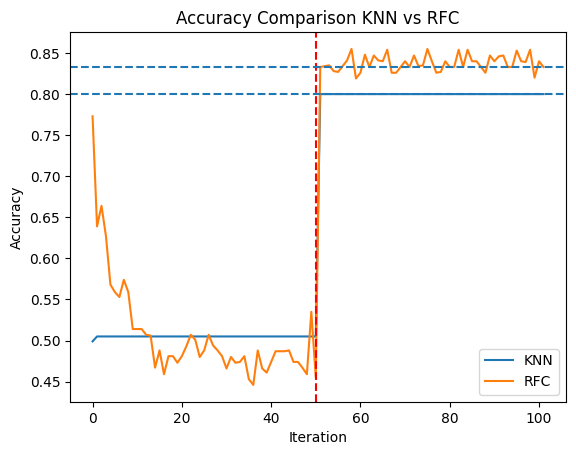

In [8]:
class_changed = 0
i = 0
while True:
    distance_array = []
    for index in range(num_columns-1):
        raisin_col = raisin.iloc[:, index]
        data_col = data.iloc[:, index]
        difference1_col = difference1.iloc[:, index]

        # Loop through the rows once and apply the conditions efficiently
        for second_index in range(150):
            raisin_value = raisin_col.iloc[second_index]
            data_value = data_col.iloc[second_index]
            difference_value = difference1_col.iloc[second_index]
            
            if raisin_value > 0:
                if data_value + difference_value > raisin_value:
                    data_col.iloc[second_index] = raisin_value
                else:
                    data_col.iloc[second_index] += difference_value
            elif raisin_value < 0:
                if data_value - difference_value < raisin_value:
                    data_col.iloc[second_index] = raisin_value
                else:
                    data_col.iloc[second_index] -= difference_value

            distance = calculate_distance(iris.iloc[second_index, index], raisin_value, data_value)
            distance_array.append(distance)
        # Assign the modified column back to the original DataFrame
        data.iloc[:, index] = data_col
            

    accuracy_overall_knn.append(calculate_stats_knn(data))
    accuracy_overall_mlp.append(calculate_stats_mlp(data))

    if is_average_greater_than_half(distance_array) and class_changed == 0:
        data.iloc[:, -1] = raisin.iloc[:, -1]
        class_changed = i
        print("Target feature changed to Raisin at index:", i)
    print("Iteration:", i, "Distance avg", np.mean(distance_array) )
    #print(distance_array)
    if np.mean(distance_array) == 1:
        print("Converged at iteration:", i)
        break
    i = i + 1


plt.plot(range(len(accuracy_overall_knn)), accuracy_overall_knn, label='KNN')
plt.plot(range(len(accuracy_overall_mlp)), accuracy_overall_mlp, label='RFC')
plt.axvline(x=class_changed, color='red', linestyle='--')
plt.axhline(y=accuracy_overall_knn[-1], linestyle='--')
plt.axhline(y=accuracy_overall_mlp[-1], linestyle='--')
plt.xlabel('Iteration')
plt.ylabel('Accuracy')
plt.title('Accuracy Comparison KNN vs RFC')
plt.legend()
plt.show()

In [9]:
# np.random.seed(137)
# percentage = 0.5
# t = np.linspace(0, 10, data.shape[0])
# for i in range(data.shape[1]-1):
#     n = np.random.normal(0, data[i].std(), t.size) * percentage
#     data[i] = data[i]+ n

In [10]:
# data = iris.copy()
# accuracy_overall = []
# percentage = 0.05
# class_changed = 0
# for i in range(600):
#     distance_array = []
#     for index in range(num_columns-1):
#         for second_index in range(150):
#             #print("Index:", index, "Second Index:", second_index)
#             delta = raisin.iloc[second_index, index] - data.iloc[second_index, index]
#             if delta > 0:
#                 if data.iloc[second_index, index] + (iris.iloc[second_index, index] * percentage) > raisin.iloc[second_index, index]:
#                     data.iloc[second_index, index] = raisin.iloc[second_index, index]
#                 else:
#                     data.iloc[second_index, index] = data.iloc[second_index, index] + (iris.iloc[second_index, index] * percentage)
#             elif delta < 0:
#                 if data.iloc[second_index, index] - (iris.iloc[second_index, index] * percentage) < raisin.iloc[second_index, index]:
#                     data.iloc[second_index, index] = raisin.iloc[second_index, index]
#                 else:
#                     data.iloc[second_index, index] = data.iloc[second_index, index] - (iris.iloc[second_index, index] * percentage)
            
#             distance = calculate_distance(iris.iloc[second_index, index], raisin.iloc[second_index, index], data.iloc[second_index, index])
#             distance_array.append(distance)

#     accuracy_overall.append(calculate_stats_mlp(data))

#     if is_average_greater_than_half(distance_array) and class_changed == 0:
#         data.iloc[:, -1] = raisin.iloc[:, -1]
#         class_changed = i
#         print("Target feature changed to Raisin at index:", i)

#     if np.mean(distance_array) == 1:
#         print("Converged at iteration:", i)
#         print(data)
#         break

# plt.plot(accuracy_overall)
# plt.axvline(x=class_changed, color='red', linestyle='--')
# plt.axhline(y=accuracy_overall[-1], color='green', linestyle='--')
# plt.xlabel('MLPClassifier - Iris -> Raisin')
# plt.ylabel('Accuracy')
# plt.title('Accuracy Overall')
# plt.show()
